In [0]:
 %tensorflow_version 2.x
import tensorflow as tf
import numpy as np

In [0]:
import pandas as pd
df = pd.read_csv("/content/drive/My Drive/SentimentAnalysis/DatatestUpdated_2.5M.csv",usecols=['reviewText','overall','Sentiment'],memory_map=True)

In [0]:
import re
import unicodedata
def unicode_to_ascii(s):
    return ''.join(c for c in unicodedata.normalize('NFD', s)
        if unicodedata.category(c) != 'Mn')
def preprocess(w):
    w = unicode_to_ascii(w.lower().strip())
    w = re.sub(r"([?.!,¿])", r" \1 ", w)
    w = re.sub(r'[" "]+', " ", w)
    w = re.sub(r"newlinechar", "", w)
    w = re.sub(r"[^a-zA-Z?.!,¿]+", " ", w)
    w = w.rstrip().strip()

    return w    

In [6]:
df.head(5)

,overall,reviewText,Sentiment
0,1.0,i used to play this game years ago and loved i...,0
1,3.0,the game itself worked great but the story lin...,1
2,4.0,i had to learn the hard way after ordering thi...,2
3,1.0,the product description should state this clea...,0
4,4.0,i would recommend this learning game for anyon...,2


In [8]:
print(df.isnull().sum())
df = df.dropna(subset=['reviewText'])
print(df.isnull().sum())

overall          0
reviewText    1317
Sentiment        0
dtype: int64
overall       0
reviewText    0
Sentiment     0
dtype: int64


In [0]:
VOCAB=20000

In [0]:
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=VOCAB)
tokenizer.fit_on_texts(df['reviewText'])

In [0]:
# import pickle
# with open('/content/drive/My Drive/SentimentAnalysis/tokenizer.pickle', 'wb') as handle:
#     pickle.dump(tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [0]:
sent = tokenizer.texts_to_sequences(df['reviewText'])
sent = tf.keras.preprocessing.sequence.pad_sequences(sent,padding='post',maxlen=50,truncating='post')

In [13]:
print(sent[:2])

[[   3  142    4   39   11   10  226  523    2  295    6    3  245   11
   135   23   95   17   21  269   70  152    6  272    6   56   95   16
   438    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0]
 [   1   10  348  288   31   15    1  107  358 1486   56  157   39    1
   164   24  283   15    1  915   56 2171    2  113  482  160   52    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0]]


In [16]:
rating = pd.get_dummies(df['overall']).to_numpy()
print(rating[:5])
sentiment = np.array(df['Sentiment'])
sentiment = tf.keras.utils.to_categorical(sentiment,num_classes=3)
print(sentiment[:5])

[[1 0 0 0 0]
 [0 0 1 0 0]
 [0 0 0 1 0]
 [1 0 0 0 0]
 [0 0 0 1 0]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]
 [1. 0. 0.]
 [0. 0. 1.]]


In [17]:
rating.shape,sentiment.shape

((2562311, 5), (2562311, 3))

In [55]:
csv = df.values
train_set = len(csv[0:int(0.7*len(csv))])
val_set = len(csv[int(0.7*len(csv)):int(0.85*len(csv))])
test_set = len(csv[int(0.85*len(csv)):int(1*len(csv))])
print(train_set,val_set,test_set)

102924 22055 22056


In [18]:
review_train = sent[0:int(0.7*len(sent))]
rating_train = rating[0:int(0.7*len(sent))]
sentiment_train = sentiment[0:int(0.7*len(sent))]
print(review_train[:5],sentiment_train[:5],rating_train[:5])

[[   3  142    4   39   11   10  226  523    2  295    6    3  245   11
   135   23   95   17   21  269   70  152    6  272    6   56   95   16
   438    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0]
 [   1   10  348  288   31   15    1  107  358 1486   56  157   39    1
   164   24  283   15    1  915   56 2171    2  113  482  160   52    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0    0    0    0    0    0    0    0]
 [   3   61    4  594    1  176  101   82 2249   11   12   21 4380  777
    14   11  170   18   95  545    9   19 1283 2441  192   36  313    3
   245   14   47   82 1758    1  955  703 1501   35  119   41 3820   13
   133 1333  185    3   73   19    5 1110]
 [   1  112 1331  177 1857   11 1349    1  900    1  321    2    1  112
  1331 1047   14    1   10    7 1149   16   33 7737    6    7   23    0
     0    0    0    0    0    0    0    0    0    0    0    0    0    0
     0 

In [20]:
review_val = sent[int(0.7*len(df)):int(0.85*len(df))]
rating_val = rating[int(0.7*len(df)):int(0.85*len(df))]
sentiment_val = sentiment[int(0.7*len(df)):int(0.85*len(df))]
print(review_val[:5],sentiment_val[:5],rating_val[:5])

[[   77     6    59   224     7    14     3   100    13    13  5985     2
     85    28     3   889     1   108  6013    17     1   108   511     1
   2674   565     2    79   230   315    16     1  1396     2     3   127
     23   223   250     3    39  2156  2170    27   337  1665    26   352
   2256    55]
 [   43    27   167    15     1   108  1237     7   174     0     0     0
      0     0     0     0     0     0     0     0     0     0     0     0
      0     0     0     0     0     0     0     0     0     0     0     0
      0     0     0     0     0     0     0     0     0     0     0     0
      0     0]
 [   30   124   378   215     3    19     5 11146   321    12    33     1
   4179     3    90   328    15   155    18    30    11    32   308   384
      6   669   359     5   414     8   635     4    40   142     4     5
     76   108    15    11    32   559    30     3    24   203     6    12
    226    31]
 [  628    46    53  1856   552     3    24   303   401     4   154

In [0]:
import time
def create_model(shape=(147035,50),lr=0.01):


    input_layer = tf.keras.layers.Input(shape=shape)

    embedding = tf.keras.layers.Embedding(VOCAB+1,128,input_length=50,mask_zero=True)(input_layer)
    sp_drop = tf.keras.layers.SpatialDropout1D(0.3)(embedding)
    lstm = tf.keras.layers.LSTM(64,recurrent_dropout=0.2,return_sequences=False)(sp_drop)

    # drop1 = tf.keras.layers.Dropout(0.3)(lstm)
    # lstm1 = tf.keras.layers.LSTM(64)(drop1)
    # drop2 = tf.keras.layers.Dropout(0.3)(lstm1)

    # dense_common1 = tf.keras.layers.Dense(32)(drop1)
    # drop3 = tf.keras.layers.Dropout(0.5)(dense_common1)
    # dense_common = tf.keras.layers.Dense(64)(drop3)
    # drop = tf.keras.layers.Dropout(0.3)(dense_common)

    dense_rating_1 = tf.keras.layers.Dense(5,activation='softmax')(lstm)

    dense_sentiment_1 = tf.keras.layers.Dense(3,activation='softmax')(lstm)
    
    model = tf.keras.models.Model(inputs=input_layer,outputs=[dense_rating_1,dense_sentiment_1])
    optimizer = tf.keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss='categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])

    return model

Model: "model_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 50)]         0                                            
__________________________________________________________________________________________________
embedding_6 (Embedding)         (None, 50, 128)      2560128     input_7[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_3 (SpatialDro (None, 50, 128)      0           embedding_6[0][0]                
__________________________________________________________________________________________________
conv1d_1 (Conv1D)               (None, 46, 64)       41024       spatial_dropout1d_3[0][0]        
____________________________________________________________________________________________

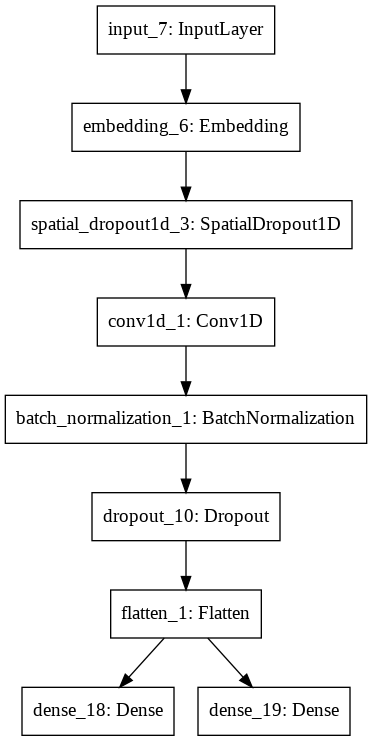

In [75]:
model = create_model(shape=(50))
print(model.summary())
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png')

In [72]:
tf.test.is_gpu_available()

True

In [76]:
EPOCHS = 10

early_stopping = tf.keras.callbacks.EarlyStopping(patience=8,restore_best_weights=True,verbose=1)
reducelr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',min_lr=1e-8,patience=5,verbose=1)
tensorboard_callback = tf.keras.callbacks.TensorBoard(histogram_freq=1,embeddings_freq = 1)
history = model.fit(x=review_train,y=[rating_train,sentiment_train],validation_data=(review_val,(rating_val,sentiment_val)),epochs=EPOCHS,callbacks=[tensorboard_callback,reducelr,early_stopping],batch_size=2048,shuffle=True)
model.save("/content/drive/My Drive/SentimentAnalysis/LSTMModel.h5")

Train on 1793617 samples, validate on 384347 samples
Epoch 1/10
1793617/1793617 [==============================] - 76s 42us/sample - loss: 1.5144 - dense_18_loss: 0.9955 - dense_19_loss: 0.5188 - dense_18_accuracy: 0.6492 - dense_19_accuracy: 0.8237 - val_loss: 1.1398 - val_dense_18_loss: 0.7561 - val_dense_19_loss: 0.3839 - val_dense_18_accuracy: 0.7218 - val_dense_19_accuracy: 0.8605
Epoch 2/10
1793617/1793617 [==============================] - 70s 39us/sample - loss: 1.2692 - dense_18_loss: 0.8446 - dense_19_loss: 0.4246 - dense_18_accuracy: 0.6790 - dense_19_accuracy: 0.8430 - val_loss: 1.1294 - val_dense_18_loss: 0.7494 - val_dense_19_loss: 0.3802 - val_dense_18_accuracy: 0.7200 - val_dense_19_accuracy: 0.8571
Epoch 3/10
1793617/1793617 [==============================] - 70s 39us/sample - loss: 1.2398 - dense_18_loss: 0.8273 - dense_19_loss: 0.4125 - dense_18_accuracy: 0.6847 - dense_19_accuracy: 0.8470 - val_loss: 1.1298 - val_dense_18_loss: 0.7497 - val_dense_19_loss: 0.3803 - v

In [89]:
%load_ext tensorboard
%tensorboard --logdir /content/logs/train/events.out.tfevents.1578736124.f8e36cd8c3f8.2814.239263.v2

Output hidden; open in https://colab.research.google.com to view.

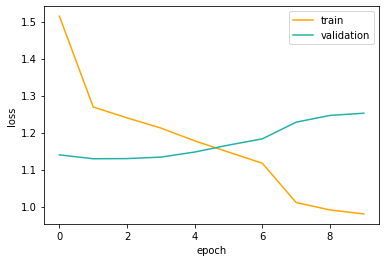

In [103]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'],color='orange')
plt.plot(history.history['val_loss'],color='lightseagreen')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()


In [0]:
model = tf.keras.models.load_model("/content/drive/My Drive/SentimentAnalysis/Dense3.h5")

In [0]:
def convert(sentence):
  # sentence = sentence.lower()
  sentence = preprocess(sentence)
  print(sentence)
  tokenized_sent = tf.keras.preprocessing.text.text_to_word_sequence(sentence)
  print(tokenized_sent)  
  tokenized_sent = tokenizer.texts_to_sequences([sentence])

  tokenized_sent = tf.keras.preprocessing.sequence.pad_sequences(tokenized_sent,maxlen=50,padding='post',truncating='post')
  print(tokenized_sent.shape)
  return tokenized_sent

In [0]:
csv = df
test_review = sent[int(0.85*len(csv)):int(1*len(csv))]
test_rating = rating[int(0.85*len(csv)):int(1*len(csv))]
test_sentiment = sentiment[int(0.85*len(csv)):int(1*len(csv))]

In [54]:
# optimizer = tf.keras.optimizers.Adam(learning_rate=0.01)
history1 = model1.fit(review_train,y=(rating_train,sentiment_train),validation_data=(review_val,(rating_val,sentiment_val)),epochs=10,batch_size=2048,callbacks=[reducelr,early_stopping])

Train on 1793617 samples, validate on 384347 samples
Epoch 1/10
1793617/1793617 [==============================] - 180s 101us/sample - loss: 1.2121 - dense_14_loss: 0.8176 - dense_15_loss: 0.3945 - dense_14_accuracy: 0.6852 - dense_15_accuracy: 0.8529 - val_loss: 0.9788 - val_dense_14_loss: 0.6695 - val_dense_15_loss: 0.3096 - val_dense_14_accuracy: 0.7479 - val_dense_15_accuracy: 0.8840
Epoch 2/10
1793617/1793617 [==============================] - 176s 98us/sample - loss: 1.0952 - dense_14_loss: 0.7511 - dense_15_loss: 0.3441 - dense_14_accuracy: 0.7077 - dense_15_accuracy: 0.8711 - val_loss: 0.9728 - val_dense_14_loss: 0.6657 - val_dense_15_loss: 0.3074 - val_dense_14_accuracy: 0.7492 - val_dense_15_accuracy: 0.8846
Epoch 3/10
1793617/1793617 [==============================] - 176s 98us/sample - loss: 1.0571 - dense_14_loss: 0.7296 - dense_15_loss: 0.3275 - dense_14_accuracy: 0.7153 - dense_15_accuracy: 0.8772 - val_loss: 0.9682 - val_dense_14_loss: 0.6641 - val_dense_15_loss: 0.3044

In [55]:
result2 = model1.evaluate(x=test_review,y=((test_rating,test_sentiment)),batch_size=512,verbose=1)
print(result2)

384347/384347 [==============================] - 34s 88us/sample - loss: 1.2307 - dense_14_loss: 0.8175 - dense_15_loss: 0.4131 - dense_14_accuracy: 0.6977 - dense_15_accuracy: 0.8543
[1.2307124444776112, 0.8175456, 0.41305214, 0.69769245, 0.8543217]


In [78]:
pred = model1.predict(convert('bad product'),verbose=1)
np.argmax(pred[0])+1,np.argmax(pred[1])

bad product
['bad', 'product']
(1, 50)
1/1 [==============================] - 0s 43ms/sample


(1, 0)

In [0]:
model.save("/content/drive/My Drive/SentimentAnalysis/FullModelR69S85.h5")